In [1]:
print("test")

test


In [2]:
%pip install requests
%pip install zeep
%pip install openml
%pip install seaborn
%pip install plotly

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [3]:
import requests
from pprint import pprint
import pandas as pd
from zeep import Client
import logging
import openml
import sqlite3
import xml.etree.ElementTree as ET


# API Number of motor vehicles 

Below you can find the end points. We will use the TypedDataSet end point.
```
{
  "odata.metadata":"https://opendata.cbs.nl/ODataApi/OData/85235NED/$metadata","value":[
    {
      "name":"TableInfos","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/TableInfos"
    },{
      "name":"UntypedDataSet","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/UntypedDataSet"
    },{
      "name":"TypedDataSet","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/TypedDataSet"
    },{
      "name":"DataProperties","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/DataProperties"
    },{
      "name":"CategoryGroups","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/CategoryGroups"
    },{
      "name":"RegioS","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/RegioS"
    },{
      "name":"Perioden","url":"https://opendata.cbs.nl/ODataApi/odata/85235NED/Perioden"
    }
  ]
}
```

In [4]:
url = "https://opendata.cbs.nl/ODataApi/odata/85235NED/TypedDataSet"
response= requests.get(url)
users= response.json()
print(users)



{'odata.metadata': 'https://opendata.cbs.nl/ODataApi/OData/85235NED/$metadata#Cbs.OData.WebAPI.TypedDataSet', 'value': [{'ID': 0, 'RegioS': 'NL01  ', 'Perioden': '2019JJ00', 'TotaalWegvoertuigen_1': 11372065, 'TotaalMotorvoertuigen_2': 10199679, 'TotaalPersonenautoS_3': 8442982, 'PersonenautoSRelatief_4': 489, 'InBezitNatuurlijkePersonen_5': 7452085, 'InBezitNatuurlijkePersonenRelatief_6': 431, 'TotaalBedrijfsvoertuigen_7': 2283037, 'TotaalBedrijfsmotorvoertuigen_8': 1110651, 'TotaalAanhangwagensEnOpleggers_9': 1172386, 'TotaalBedrijfsmotorvoertuigen_10': 1110651, 'Bestelauto_11': 903005, 'VrachtautoExclTrekkerVoorOplegger_12': 61652, 'TrekkerVoorOplegger_13': 78788, 'SpeciaalVoertuig_14': 57693, 'Bus_15': 9513, 'TotaalAanhangwagensEnOpleggers_16': 1172386, 'Aanhangwagen_17': 1008412, 'Oplegger_18': 163974, 'TotaalMotorfietsen_19': 646046, 'MotorfietsenRelatief_20': 37}, {'ID': 1, 'RegioS': 'NL01  ', 'Perioden': '2020JJ00', 'TotaalWegvoertuigen_1': 11567203, 'TotaalMotorvoertuigen_2': 

##### In order to make the output above more readable print the following cell

In [5]:
#this will print the typed dataset in json format, so name value pairs
url = "https://opendata.cbs.nl/ODataApi/odata/85235NED/TypedDataSet"
posts = requests.get(url).json()

pprint (posts)





{'odata.metadata': 'https://opendata.cbs.nl/ODataApi/OData/85235NED/$metadata#Cbs.OData.WebAPI.TypedDataSet',
 'value': [{'Aanhangwagen_17': 1008412,
            'Bestelauto_11': 903005,
            'Bus_15': 9513,
            'ID': 0,
            'InBezitNatuurlijkePersonenRelatief_6': 431,
            'InBezitNatuurlijkePersonen_5': 7452085,
            'MotorfietsenRelatief_20': 37,
            'Oplegger_18': 163974,
            'Perioden': '2019JJ00',
            'PersonenautoSRelatief_4': 489,
            'RegioS': 'NL01  ',
            'SpeciaalVoertuig_14': 57693,
            'TotaalAanhangwagensEnOpleggers_16': 1172386,
            'TotaalAanhangwagensEnOpleggers_9': 1172386,
            'TotaalBedrijfsmotorvoertuigen_10': 1110651,
            'TotaalBedrijfsmotorvoertuigen_8': 1110651,
            'TotaalBedrijfsvoertuigen_7': 2283037,
            'TotaalMotorfietsen_19': 646046,
            'TotaalMotorvoertuigen_2': 10199679,
            'TotaalPersonenautoS_3': 8442982,
   

In [6]:
# select columns by first selecting the "value" key from json format
# then specify the specific columns
dfposts = pd.DataFrame(posts["value"])[['Aanhangwagen_17',
            'Bestelauto_11',
            'Bus_15',
            'ID',
            'InBezitNatuurlijkePersonenRelatief_6',
            'InBezitNatuurlijkePersonen_5',
            'MotorfietsenRelatief_20',
            'Oplegger_18',
            'Perioden',
            'PersonenautoSRelatief_4',
            'RegioS',
            'SpeciaalVoertuig_14',
            'TotaalAanhangwagensEnOpleggers_16',
            'TotaalAanhangwagensEnOpleggers_9',
            'TotaalBedrijfsmotorvoertuigen_10',
            'TotaalBedrijfsmotorvoertuigen_8',
            'TotaalBedrijfsvoertuigen_7',
            'TotaalMotorfietsen_19',
            'TotaalMotorvoertuigen_2',
            'TotaalPersonenautoS_3',
            'TotaalWegvoertuigen_1',
            'TrekkerVoorOplegger_13',
            'VrachtautoExclTrekkerVoorOplegger_12']]
dfposts.head()



,Aanhangwagen_17,Bestelauto_11,Bus_15,ID,InBezitNatuurlijkePersonenRelatief_6,InBezitNatuurlijkePersonen_5,MotorfietsenRelatief_20,Oplegger_18,Perioden,PersonenautoSRelatief_4,...,TotaalAanhangwagensEnOpleggers_9,TotaalBedrijfsmotorvoertuigen_10,TotaalBedrijfsmotorvoertuigen_8,TotaalBedrijfsvoertuigen_7,TotaalMotorfietsen_19,TotaalMotorvoertuigen_2,TotaalPersonenautoS_3,TotaalWegvoertuigen_1,TrekkerVoorOplegger_13,VrachtautoExclTrekkerVoorOplegger_12
0,1008412,903005,9513,0,431,7452085,37,163974,2019JJ00,489,...,1172386,1110651,1110651,2283037,646046,10199679,8442982,11372065,78788,61652
1,1023980,927251,9699,1,434,7548770,38,168502,2020JJ00,493,...,1192482,1135943,1135943,2328425,654387,10374721,8584391,11567203,80118,61746
2,1029636,945433,9050,2,440,7683236,38,170014,2021JJ00,497,...,1199650,1151740,1151740,2351390,666597,10504756,8686419,11704406,79932,60831
3,1051486,974792,8532,3,444,7803950,39,177294,2022JJ00,502,...,1228780,1182857,1182857,2411637,677787,10688353,8827709,11917133,82436,60867
4,1069827,989841,8756,4,440,7842473,39,185262,2023JJ00,501,...,1255089,1201061,1201061,2456150,690724,10808892,8917107,12063981,85679,60811


In [7]:
dfposts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119 entries, 0 to 118
Data columns (total 23 columns):
 #   Column                                Non-Null Count  Dtype 
---  ------                                --------------  ----- 
 0   Aanhangwagen_17                       119 non-null    int64 
 1   Bestelauto_11                         119 non-null    int64 
 2   Bus_15                                119 non-null    int64 
 3   ID                                    119 non-null    int64 
 4   InBezitNatuurlijkePersonenRelatief_6  119 non-null    int64 
 5   InBezitNatuurlijkePersonen_5          119 non-null    int64 
 6   MotorfietsenRelatief_20               119 non-null    int64 
 7   Oplegger_18                           119 non-null    int64 
 8   Perioden                              119 non-null    object
 9   PersonenautoSRelatief_4               119 non-null    int64 
 10  RegioS                                119 non-null    object
 11  SpeciaalVoertuig_14             

In [8]:
dfposts.describe(include="all")

,Aanhangwagen_17,Bestelauto_11,Bus_15,ID,InBezitNatuurlijkePersonenRelatief_6,InBezitNatuurlijkePersonen_5,MotorfietsenRelatief_20,Oplegger_18,Perioden,PersonenautoSRelatief_4,...,TotaalAanhangwagensEnOpleggers_9,TotaalBedrijfsmotorvoertuigen_10,TotaalBedrijfsmotorvoertuigen_8,TotaalBedrijfsvoertuigen_7,TotaalMotorfietsen_19,TotaalMotorvoertuigen_2,TotaalPersonenautoS_3,TotaalWegvoertuigen_1,TrekkerVoorOplegger_13,VrachtautoExclTrekkerVoorOplegger_12
count,1.190000e+02,1.190000e+02,119.000000,119.000000,119.000000,1.190000e+02,119.000000,119.00000,119,119.000000,...,1.190000e+02,1.190000e+02,1.190000e+02,1.190000e+02,119.000000,1.190000e+02,1.190000e+02,1.190000e+02,119.000000,119.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019JJ00,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,1.854826e+05,1.713652e+05,1599.781513,59.000000,458.327731,1.371150e+06,41.445378,31314.02521,NaN,531.352941,...,2.167967e+05,2.084077e+05,2.084077e+05,4.252043e+05,119986.058824,1.885717e+06,1.557323e+06,2.102513e+06,14653.285714,10856.092437
std,2.359257e+05,2.222785e+05,2209.500400,34.496377,43.597953,1.791485e+06,6.256790,41848.47121,NaN,92.283424,...,2.769861e+05,2.701247e+05,2.701247e+05,5.464519e+05,155689.531752,2.460088e+06,2.034669e+06,2.735181e+06,19137.159198,14132.059518
min,2.181000e+04,2.361800e+04,51.000000,0.000000,375.000000,1.728080e+05,30.000000,2359.00000,NaN,421.000000,...,2.416900e+04,2.922200e+04,2.922200e+04,6.392300e+04,15091.000000,2.477690e+05,2.013010e+05,2.824700e+05,1414.000000,1156.000000
25%,6.106750e+04,4.746650e+04,367.000000,29.500000,422.500000,3.145290e+05,36.000000,4977.00000,NaN,494.500000,...,6.587250e+04,5.816600e+04,5.816600e+04,1.226150e+05,30465.500000,4.397930e+05,3.646235e+05,4.965140e+05,3261.000000,2796.000000
50%,1.131420e+05,1.111590e+05,901.000000,59.000000,469.000000,8.491200e+05,41.000000,16419.00000,NaN,525.000000,...,1.295610e+05,1.382770e+05,1.382770e+05,2.881580e+05,83721.000000,1.132392e+06,9.093020e+05,1.306028e+06,7841.000000,6062.000000
75%,1.834855e+05,1.717850e+05,1628.000000,88.500000,492.500000,1.504870e+06,45.500000,39000.00000,NaN,545.500000,...,2.208010e+05,2.096705e+05,2.096705e+05,4.280710e+05,121018.500000,1.981126e+06,1.656020e+06,2.177265e+06,17043.000000,12079.500000


In [9]:
dfposts.isnull().sum()

Aanhangwagen_17                         0
Bestelauto_11                           0
Bus_15                                  0
ID                                      0
InBezitNatuurlijkePersonenRelatief_6    0
InBezitNatuurlijkePersonen_5            0
MotorfietsenRelatief_20                 0
Oplegger_18                             0
Perioden                                0
PersonenautoSRelatief_4                 0
RegioS                                  0
SpeciaalVoertuig_14                     0
TotaalAanhangwagensEnOpleggers_16       0
TotaalAanhangwagensEnOpleggers_9        0
TotaalBedrijfsmotorvoertuigen_10        0
TotaalBedrijfsmotorvoertuigen_8         0
TotaalBedrijfsvoertuigen_7              0
TotaalMotorfietsen_19                   0
TotaalMotorvoertuigen_2                 0
TotaalPersonenautoS_3                   0
TotaalWegvoertuigen_1                   0
TrekkerVoorOplegger_13                  0
VrachtautoExclTrekkerVoorOplegger_12    0
dtype: int64

#### Since we want to use this data to portray the impact of cars in specific regions on the air quality, we choose to use the following attributes from this data source:
```
columns_vehicledb = ['Aanhangwagen_17',
            'Bestelauto_11',
            'Bus_15',
            'InBezitNatuurlijkePersonenRelatief_6',
            'InBezitNatuurlijkePersonen_5',
            'MotorfietsenRelatief_20',
            'Oplegger_18',
            'PersonenautoSRelatief_4',
            'SpeciaalVoertuig_14',
            'TotaalAanhangwagensEnOpleggers_16',
            'TotaalAanhangwagensEnOpleggers_9',
            'TotaalBedrijfsmotorvoertuigen_10',
            'TotaalBedrijfsmotorvoertuigen_8',
            'TotaalBedrijfsvoertuigen_7',
            'TotaalMotorfietsen_19',
            'TotaalMotorvoertuigen_2',
            'TotaalPersonenautoS_3',
            'TotaalWegvoertuigen_1',
            'TrekkerVoorOplegger_13',
            'VrachtautoExclTrekkerVoorOplegger_12']

```

In [10]:
print(dfposts["RegioS"].nunique(), "different regions")
print(dfposts["RegioS"].unique())
print(dfposts["RegioS"].value_counts())

17 different regions
['NL01  ' 'LD01  ' 'LD02  ' 'LD03  ' 'LD04  ' 'PV20  ' 'PV21  ' 'PV22  '
 'PV23  ' 'PV24  ' 'PV25  ' 'PV26  ' 'PV27  ' 'PV28  ' 'PV29  ' 'PV30  '
 'PV31  ']
RegioS
NL01      7
PV24      7
PV30      7
PV29      7
PV28      7
PV27      7
PV26      7
PV25      7
PV23      7
LD01      7
PV22      7
PV21      7
PV20      7
LD04      7
LD03      7
LD02      7
PV31      7
Name: count, dtype: int64


There are 17 different regios, divided in the following two categories: LD (landsdeel) and PV (provincies). We choose to primiraly focus on provinces due to data granularity. 

In [11]:
dfprovince = dfposts[dfposts["RegioS"].str.startswith("PV")]
print(dfprovince)

     Aanhangwagen_17  Bestelauto_11  Bus_15   ID  \
35             44354          31359      99   35   
36             45012          32179     291   36   
37             45677          33225     343   37   
38             46662          34112     346   38   
39             47653          34680     372   39   
..               ...            ...     ...  ...   
114            70317          52209     351  114   
115            72178          53705     332  115   
116            74049          54396     361  116   
117            74725          55128     362  117   
118            75962          56734     352  118   

     InBezitNatuurlijkePersonenRelatief_6  InBezitNatuurlijkePersonen_5  \
35                                    431                        251789   
36                                    436                        255316   
37                                    444                        260707   
38                                    450                        265561   


https://standaarden.overheid.nl/tooi/waardelijsten/expression?lijst_uri=https%3A%2F%2Fidentifier.overheid.nl%2Ftooi%2Fset%2Frwc_provincies_compleet%2F1

This website was used to create the encoded values

In [12]:
columns_vehicledb = ['Aanhangwagen_17',
            'Bestelauto_11',
            'Bus_15',
            'InBezitNatuurlijkePersonenRelatief_6',
            'InBezitNatuurlijkePersonen_5',
            'MotorfietsenRelatief_20',
            'Oplegger_18',
            'PersonenautoSRelatief_4',
            'SpeciaalVoertuig_14',
            'TotaalAanhangwagensEnOpleggers_16',
            'TotaalAanhangwagensEnOpleggers_9',
            'TotaalBedrijfsmotorvoertuigen_10',
            'TotaalBedrijfsmotorvoertuigen_8',
            'TotaalBedrijfsvoertuigen_7',
            'TotaalMotorfietsen_19',
            'TotaalMotorvoertuigen_2',
            'TotaalPersonenautoS_3',
            'TotaalWegvoertuigen_1',
            'TrekkerVoorOplegger_13',
            'VrachtautoExclTrekkerVoorOplegger_12']

pvencoding = {'PV20':'Groningen',
              'PV21':'Friesland',
              'PV22':'Drenthe',
              'PV23':'Overijssel',  
              'PV24':'Flevoland',
              'PV25':'Gelderland',
              'PV26':'Utrecht',
              'PV27':'Noord-Holland',
              'PV28':'Zuid-Holland',
              'PV29':'Zeeland',
              'PV30':'Noord-Brabant',
              'PV31':'Limburg'}


dfprovince = dfprovince.groupby('RegioS')[columns_vehicledb].sum().reset_index()
dfprovince["Sum"] = dfprovince[columns_vehicledb].sum(axis=1)
dfprovince['RegioS'] = dfprovince['RegioS'].astype(str).str.strip()
dfprovince['RegioS'] = dfprovince['RegioS'].map(pvencoding)
print(dfprovince[["RegioS","Sum"]])


           RegioS       Sum
0       Groningen  11936457
1       Friesland  14990976
2         Drenthe  11755668
3      Overijssel  25136738
4       Flevoland  12550586
5      Gelderland  43979534
6         Utrecht  27202822
7   Noord-Holland  47438165
8    Zuid-Holland  62190626
9         Zeeland   8732228
10  Noord-Brabant  57201144
11        Limburg  23560147


#### Check if this also contains the LD values

In [13]:
dftotal = dfprovince.groupby('RegioS')[columns_vehicledb].sum().sum()

dftotal["Sum"] = dftotal[columns_vehicledb].sum()

print(dftotal)

Aanhangwagen_17                           7357478
Bestelauto_11                             6797487
Bus_15                                      63458
InBezitNatuurlijkePersonenRelatief_6        38589
InBezitNatuurlijkePersonen_5             54388946
MotorfietsenRelatief_20                      3503
Oplegger_18                               1242123
PersonenautoSRelatief_4                     45252
SpeciaalVoertuig_14                        394020
TotaalAanhangwagensEnOpleggers_16         8599601
TotaalAanhangwagensEnOpleggers_9          8599601
TotaalBedrijfsmotorvoertuigen_10          8266837
TotaalBedrijfsmotorvoertuigen_8           8266837
TotaalBedrijfsvoertuigen_7               16866438
TotaalMotorfietsen_19                     4759447
TotaalMotorvoertuigen_2                  74800095
TotaalPersonenautoS_3                    61773811
TotaalWegvoertuigen_1                    83399696
TrekkerVoorOplegger_13                     581247
VrachtautoExclTrekkerVoorOplegger_12       430625


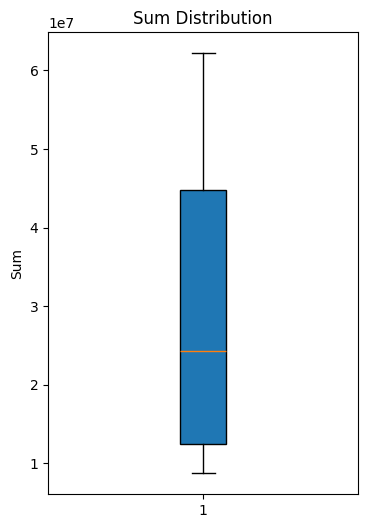

In [14]:
import matplotlib.pyplot as plt
plt.figure(figsize=(4,6))
sum = dfprovince['Sum'].dropna() # If you don't remove NANs, default matplotlib function will fail
plt.boxplot(sum, vert=True, patch_artist=True)
plt.title("Sum Distribution")
plt.ylabel("Sum")
plt.show()

Made this visualization code with Farheen.

In [15]:
%pip install --upgrade nbformat

Note: you may need to restart the kernel to use updated packages.


In [16]:
import plotly.express as px


bar = px.bar(dfprovince, x='RegioS', y= 'Sum', title='Bar chart of sum of cars per region')
bar.update_layout(yaxis_title='Sum of cars', xaxis_title= "Region Code", barmode='group') 

bar.show()

##### Standardize numerical data below, so that this data could be used for the predictive part (machine learning algorithms, such as SVM, dbscan, etc.)

https://www.datacamp.com/tutorial/normalization-vs-standardization


In [17]:
from sklearn.preprocessing import StandardScaler

standardization = dfprovince[['Aanhangwagen_17',
            'Bestelauto_11',
            'Bus_15',
            'InBezitNatuurlijkePersonenRelatief_6',
            'InBezitNatuurlijkePersonen_5',
            'MotorfietsenRelatief_20',
            'Oplegger_18',
            'PersonenautoSRelatief_4',
            'SpeciaalVoertuig_14',
            'TotaalAanhangwagensEnOpleggers_16',
            'TotaalAanhangwagensEnOpleggers_9',
            'TotaalBedrijfsmotorvoertuigen_10',
            'TotaalBedrijfsmotorvoertuigen_8',
            'TotaalBedrijfsvoertuigen_7',
            'TotaalMotorfietsen_19',
            'TotaalMotorvoertuigen_2',
            'TotaalPersonenautoS_3',
            'TotaalWegvoertuigen_1',
            'TrekkerVoorOplegger_13',
            'VrachtautoExclTrekkerVoorOplegger_12']]


standardize = StandardScaler().fit_transform(standardization)

dfstandardization = pd.DataFrame(standardize, columns=standardization.columns)
print(dfstandardization)

    Aanhangwagen_17  Bestelauto_11    Bus_15  \
0         -0.826098      -0.964925 -0.580957   
1         -0.491041      -0.676733  0.872484   
2         -0.723266      -1.008951 -0.931738   
3          0.210462      -0.215500  0.309090   
4         -1.310117      -0.711399 -1.004122   
5          1.461661       0.782840 -0.493932   
6         -0.431911       0.090297  0.308059   
7          0.523144       1.021050  2.670520   
8          1.177683       1.695970  0.593468   
9         -1.131960      -1.141830 -0.797901   
10         1.852307       1.695805 -0.364220   
11        -0.310864      -0.566621 -0.580751   

    InBezitNatuurlijkePersonenRelatief_6  InBezitNatuurlijkePersonen_5  \
0                              -0.305425                     -0.884965   
1                               0.691308                     -0.751204   
2                               1.356838                     -0.893761   
3                               0.153884                     -0.228767   
4    

#### IMPORTANT: CHOOSE SAMPLING DURING THE PREDICTIVE PART. IT IS NOW NOT POSSIBLE TO CHOOSE THIS, BECAUSE THE SAMPLES NEEDS TO BE ALIGNED WITH PM2.5 PM10 AND NO2 DATA.

# API Luchtmeetnet

In this part of the code, we will retrieve data from the luchtmeetnet api. We filter through the measurements using ?formula=NO2 , ?formula=PM10 and ?formula=PM25  

In [18]:
url_province = "https://api.luchtmeetnet.nl/open_api/stations"
posts_luchtmeetnet_province = requests.get(url_province).json()
pprint(posts_luchtmeetnet_province)


{'data': [{'location': 'Overschie-A13', 'number': 'NL01491'},
          {'location': 'Rotterdam-Maasvlakte', 'number': 'NL01497'},
          {'location': 'Rotterdam-HvHolland', 'number': 'NL01496'},
          {'location': 'Wijk aan Zee-Bosweg', 'number': 'NL49557'},
          {'location': 'Nistelrode-Gagelstraat', 'number': 'NL10248'},
          {'location': 'Ridderkerk-Voorweg', 'number': 'NL01912'},
          {'location': 'Meerssen- Beekerweg', 'number': 'NL50013'},
          {'location': 'Eijsden-Trichterweg', 'number': 'NL50012'},
          {'location': 'Rotterdam-Hoogvliet', 'number': 'NL01485'},
          {'location': 'Ridderkerk-A16', 'number': 'NL01489'},
          {'location': 'Zaandam-Wagenschotpad', 'number': 'NL49701'},
          {'location': 'Burgh-Haamstede', 'number': 'NL10320'},
          {'location': 'Zevenbergen-Galgenweg', 'number': 'NL53016'},
          {'location': 'Den Haag-Rebecquestraat', 'number': 'NL10404'},
          {'location': 'Den Haag-Amsterdamse Veerkad

In [19]:
dfposts_NO2_province = pd.DataFrame(posts_luchtmeetnet_province["data"])[['location','number']]
dfposts_NO2_province.head(10)

,location,number
0,Overschie-A13,NL01491
1,Rotterdam-Maasvlakte,NL01497
2,Rotterdam-HvHolland,NL01496
3,Wijk aan Zee-Bosweg,NL49557
4,Nistelrode-Gagelstraat,NL10248
5,Ridderkerk-Voorweg,NL01912
6,Meerssen- Beekerweg,NL50013
7,Eijsden-Trichterweg,NL50012
8,Rotterdam-Hoogvliet,NL01485
9,Ridderkerk-A16,NL01489


In [20]:
url = "https://api.luchtmeetnet.nl/open_api/measurements?formula=NO2" # get data from luchtmeetnet api and filter it so that only NO2 formulas will be retrieved
posts_luchtmeetnet_NO2 = requests.get(url).json()
#pprint(posts_luchtmeetnet_NO2)



In [21]:
dfposts_NO2 = pd.DataFrame(posts_luchtmeetnet_NO2["data"])[['formula',
           'station_number',
           'timestamp_measured',
           'value']]
print(dfposts_NO2.head(10))



  formula station_number         timestamp_measured  value
0     NO2        NL10450  2025-10-13T12:00:00+00:00  29.84
1     NO2        NL10444  2025-10-13T12:00:00+00:00   2.98
2     NO2        NL01494  2025-10-13T12:00:00+00:00  17.00
3     NO2        NL49019  2025-10-13T12:00:00+00:00   9.60
4     NO2        NL10639  2025-10-13T12:00:00+00:00  12.00
5     NO2        NL49014  2025-10-13T12:00:00+00:00   7.70
6     NO2        NL10131  2025-10-13T12:00:00+00:00   3.67
7     NO2        NL01489  2025-10-13T12:00:00+00:00   7.40
8     NO2        NL49017  2025-10-13T12:00:00+00:00  14.30
9     NO2        NL10918  2025-10-13T12:00:00+00:00   2.99


In [22]:
meanlocation = dfposts_NO2.groupby('station_number')['value'].mean().reset_index()

print(meanlocation)

   station_number      value
0         NL01485  13.545455
1         NL01487   9.961538
2         NL01488  10.769231
3         NL01489   6.061538
4         NL01491   7.230769
..            ...        ...
74        NL49704   9.558333
75        NL50002   7.181818
76        NL50003   5.727273
77        NL50010   8.363636
78        NL54004  13.952308

[79 rows x 2 columns]


In [23]:
bar = px.bar(meanlocation, x='station_number' , y= 'value', title='Average µg/m³ NO2 per station')
bar.update_layout(yaxis_title='NO2 in µg/m³', xaxis_title= "Station numbers", barmode='group') 
#bar.add_shape(type='line', y0=40, y1=40, xref='paper', x0=0, x1=1, line_color='red')
bar.add_shape(
    legendrank=1,
    showlegend=True,
    type="line",
    xref="paper",
    line=dict(dash="5px", color='red'),
    x0=1,
    x1=0,
    y0=40,
    y1=40,
    name='Threshold of 40 µg/m³'
)

bar.show()

In [24]:
NO2_pvencoding = NO2_pvencoding = {'NL49703': 'Noord-Holland',
                  'NL49553': 'Noord-Holland',
                  'NL01493': 'Zuid-Holland',
                  'NL10404': 'Zuid-Holland',
                  'NL10318': 'Zeeland',
                  'NL01912': 'Zeeland',
                  'NL10742': 'Groningen',
                  'NL10538': 'Noord-Holland',
                  'NL01496': 'Zuid-Holland',
                  'NL01495': 'Zuid-Holland', 
                  'NL49007': 'Noord-Holland',
                  'NL10636': 'Utrecht',
                  'NL49564': 'Noord-Holland',
                  'NL10818': 'Overijssel',
                  'NL10550': 'Noord-Holland',
                  'NL49546': 'Noord-Holland',
                  'NL10136': 'Limburg',
                  'NL10235': 'Noord-Brabant',
                  'NL01913': 'Zeeland',
                  'NL10918': 'Friesland',
                  'NL01487': 'Zuid-Holland',
                  'NL10639': 'Utrecht',
                  'NL01497': 'Zeeland',
                  'NL10644': 'Utrecht',
                  'NL10633': 'Utrecht',
                  'NL10741': 'Gelderland',
                  'NL10437': 'Zeeland',
                  'NL10247':'Noord-Brabant', 
                  'NL10445':'Zeeland',
                  'NL10934': 'Friesland',
                  'NL01494': 'Zuid-Holland',
                  'NL10449': 'Zuid-Holland',
                  'NL49017': 'Noord-Holland',
                  'NL49551': 'Noord-Holland',
                  'NL10617': 'Flevoland', 
                  'NL10442': 'Zuid-Holland',
                  'NL10446': 'Zuid-Holland',
                  'NL49565': 'Noord-Holland',
                  'NL10418':'Zuid-Holland',
                  'NL10138': 'Limburg',
                  'NL10450': 'Zuid-Holland',
                  'NL10929': 'Drenthe',
                  'NL49561': 'Noord-Holland', 
                  'NL01485': 'Zuid-Holland',
                  'NL49003': 'Noord-Holland',
                  'NL10246': 'Noord-Brabant', 
                  'NL10133': 'Limburg',
                  'NL49020': 'Noord-Holland', 
                  'NL10444': 'Zuid-Holland',  
                  'NL10738': 'Gelderland',
                  'NL10107': 'Groningen',
                  'NL49680': 'Flevoland', 
                  'NL10643': 'Zuid-Holland', 
                  'NL10248': 'Noord-Brabant', 
                  'NL10240': 'Noord-Holland', 
                  'NL10230': 'Noord-Brabant',
                  'NL10131': 'Limburg', 
                  'NL49021': 'Noord-Holland',
                  'NL10938': 'Zuid-Holland',
                  'NL49019': 'Noord-Holland',
                  'NL49014': 'Noord-Holland',
                  'NL10641': 'Utrecht', 
                  'NL10237': 'Noord-Brabant',
                  'NL01491': 'Zuid-Holland',
                  'NL10236': 'Noord-Brabant',
                  'NL10241': 'Noord-Brabant',
                  'NL49701': 'Noord-Holland',
                  'NL49012': 'Noord-Holland', 
                  'NL10722': 'Gelderland',
                  'NL49704':'Noord-Holland',
                  'NL10807': 'Overijssel',
                  'NL01488': 'Zuid-Holland', 
                  'NL10301': 'Groningen',
                  'NL10937': 'Groningen',
                  'NL49002': 'Noord-Holland',
                  'NL50010': 'Limburg',
                  'NL50002': 'Limburg', 
                  'NL50003': 'Limburg',
                  'NL54004':'Gelderland',
                  'NL01489': 'Zuid-Holland'}

dfposts_NO2['RegioS']  = dfposts_NO2['station_number'].map(NO2_pvencoding)
meanprovince = dfposts_NO2.groupby('RegioS')['value'].mean().reset_index()

print(meanprovince)


           RegioS      value
0         Drenthe   2.979231
1       Flevoland   2.663200
2       Friesland   2.227600
3      Gelderland   9.902885
4       Groningen  10.110392
5         Limburg   6.774881
6   Noord-Brabant   8.673793
7   Noord-Holland  10.297500
8      Overijssel   2.213462
9         Utrecht   6.271935
10        Zeeland  11.822500
11   Zuid-Holland  11.333217


In [25]:
print(meanprovince)

           RegioS      value
0         Drenthe   2.979231
1       Flevoland   2.663200
2       Friesland   2.227600
3      Gelderland   9.902885
4       Groningen  10.110392
5         Limburg   6.774881
6   Noord-Brabant   8.673793
7   Noord-Holland  10.297500
8      Overijssel   2.213462
9         Utrecht   6.271935
10        Zeeland  11.822500
11   Zuid-Holland  11.333217


In [26]:
dfposts_NO2['RegioS']
mean_pv = dfposts_NO2.groupby('RegioS')['value'].mean().reset_index()
print(mean_pv)


           RegioS      value
0         Drenthe   2.979231
1       Flevoland   2.663200
2       Friesland   2.227600
3      Gelderland   9.902885
4       Groningen  10.110392
5         Limburg   6.774881
6   Noord-Brabant   8.673793
7   Noord-Holland  10.297500
8      Overijssel   2.213462
9         Utrecht   6.271935
10        Zeeland  11.822500
11   Zuid-Holland  11.333217


### Note for visualization team: add legend for the red line which represent the threshold.

In [27]:
import plotly.express as px
import plotly.graph_objects as go


bar = px.bar(meanlocation, x=NO2_pvencoding, y= 'value', title='total µg/m³ NO2 per region')
bar.update_layout(yaxis_title='NO2 in µg/m³', xaxis_title= "Station numbers", barmode='group') 
#bar.add_shape(type='line', y0=40, y1=40, xref='paper', x0=0, x1=1, line_color='red')
bar.add_shape(
    legendrank=1,
    showlegend=True,
    type="line",
    xref="paper",
    line=dict(dash="5px", color='red'),
    x0=1,
    x1=0,
    y0=40,
    y1=40,
    name='Threshold of 40 µg/m³'
)

bar.show()

ValueError: All arguments should have the same length. The length of column argument `df[y]` is 79, whereas the length of previously-processed arguments ['x'] is 80

In [ ]:
print(NO2_pvencoding)
print(dfposts_NO2['RegioS'])
dfposts_NO2.info()

{'NL49703': 'Noord-Holland', 'NL49553': 'Noord-Holland', 'NL01493': 'Zuid-Holland', 'NL10404': 'Zuid-Holland', 'NL10318': 'Zeeland', 'NL01912': 'Zeeland', 'NL10742': 'Groningen', 'NL10538': 'Noord-Holland', 'NL01496': 'Zuid-Holland', 'NL01495': 'Zuid-Holland', 'NL49007': 'Noord-Holland', 'NL10636': 'Utrecht', 'NL49564': 'Noord-Holland', 'NL10818': 'Overijssel', 'NL10550': 'Noord-Holland', 'NL49546': 'Noord-Holland', 'NL10136': 'Limburg', 'NL10235': 'Noord-Brabant', 'NL01913': 'Zeeland', 'NL10918': 'Friesland', 'NL01487': 'Zuid-Holland', 'NL10639': 'Utrecht', 'NL01497': 'Zeeland', 'NL10644': 'Utrecht', 'NL10633': 'Utrecht', 'NL10741': 'Gelderland', 'NL10437': 'Zeeland', 'NL10247': 'Noord-Brabant', 'NL10445': 'Zeeland', 'NL10934': 'Friesland', 'NL01494': 'Zuid-Holland', 'NL10449': 'Zuid-Holland', 'NL49017': 'Noord-Holland', 'NL49551': 'Noord-Holland', 'NL10617': 'Flevoland', 'NL10442': 'Zuid-Holland', 'NL10446': 'Zuid-Holland', 'NL49565': 'Noord-Holland', 'NL10418': 'Zuid-Holland', 'NL10

In [ ]:
print(meanprovince)
print('Mean NO2 value:', meanprovince['value'].mean())

           RegioS      value
0         Drenthe   1.808462
1       Flevoland   8.528750
2       Friesland   1.605200
3      Gelderland  12.053846
4       Groningen   8.498235
5         Limburg   9.615698
6   Noord-Brabant  11.293500
7   Noord-Holland  14.927510
8      Overijssel   2.879615
9         Utrecht   9.857222
10        Zeeland  10.508816
11   Zuid-Holland  15.516104
Mean NO2 value: 8.924413140073801


In [ ]:
import plotly.express as px
import plotly.graph_objects as go

pv = ['Groningen', 'Friesland', 'Drenthe', 'Overijssel', 'Gelderland', 'Flevoland',
      'Utrecht', 'Noord-Holland', 'Zuid-Holland', 'Noord-Brabant', 'Limburg', 'Zeeland' ]

pv_mean = meanprovince[meanprovince['RegioS'].isin(pv)]
bar = px.bar(meanprovince, x='RegioS' , y= dfposts_NO2.groupby('RegioS')['value'].mean(), title='Average µg/m³ NO2 per Region')
bar.update_layout(yaxis_title='NO2 in µg/m³', xaxis_title= "Station numbers", barmode='group') 
#bar.add_shape(type='line', y0=40, y1=40, xref='paper', x0=0, x1=1, line_color='red')
bar.add_shape(
    legendrank=1,
    showlegend=True,
    type="line",
    xref="paper",
    line=dict(dash="5px", color='red'),
    x0=1,
    x1=0,
    y0=40,
    y1=40,
    name='Threshold of 40 µg/m³'
)

bar.show()

In [ ]:
dfposts_NO2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   formula             1000 non-null   object 
 1   station_number      1000 non-null   object 
 2   timestamp_measured  1000 non-null   object 
 3   value               1000 non-null   float64
 4   RegioS              987 non-null    object 
dtypes: float64(1), object(4)
memory usage: 39.2+ KB


In [ ]:
print(dfposts_NO2["station_number"].isna().sum())
print(dfposts_NO2["station_number"].nunique(), "station points")
print(dfposts_NO2["station_number"].unique())
print(dfposts_NO2["station_number"].value_counts())

0
80 station points
['NL01493' 'NL10230' 'NL10929' 'NL10136' 'NL49680' 'NL10738' 'NL49551'
 'NL10643' 'NL10442' 'NL10633' 'NL10741' 'NL10241' 'NL10918' 'NL10934'
 'NL49002' 'NL10722' 'NL49020' 'NL10449' 'NL01495' 'NL10107' 'NL10131'
 'NL49019' 'NL01487' 'NL01912' 'NL10248' 'NL10639' 'NL10138' 'NL49546'
 'NL10644' 'NL49553' 'NL10246' 'NL10404' 'NL49561' 'NL10446' 'NL10550'
 'NL01494' 'NL10807' 'NL01491' 'NL01913' 'NL10418' 'NL10742' 'NL01497'
 'NL10445' 'NL10450' 'NL49007' 'NL10301' 'NL10240' 'NL10818' 'NL10318'
 'NL49003' 'NL01485' 'NL49022' 'NL54004' 'NL01489' 'NL10133' 'NL49565'
 'NL49021' 'NL10444' 'NL10437' 'NL49703' 'NL49012' 'NL10636' 'NL49701'
 'NL10237' 'NL49017' 'NL01488' 'NL10247' 'NL49564' 'NL10938' 'NL49704'
 'NL10236' 'NL49014' 'NL10937' 'NL50002' 'NL50003' 'NL01496' 'NL50010'
 'NL10235' 'NL10641' 'NL10617']
station_number
NL01493    13
NL10247    13
NL01494    13
NL10807    13
NL01491    13
           ..
NL10445    11
NL50010    11
NL10235    10
NL10641     3
NL10617     

In [ ]:
dfposts_NO2.describe(include="all")

,formula,station_number,timestamp_measured,value,RegioS
count,1000,1000,1000,1000.000000,987
unique,1,80,13,NaN,12
top,NO2,NL01493,2025-10-12T05:00:00+00:00,NaN,Noord-Holland
freq,1000,13,80,NaN,257
mean,NaN,NaN,NaN,12.167530,NaN
std,NaN,NaN,NaN,10.751882,NaN
min,NaN,NaN,NaN,0.050000,NaN
25%,NaN,NaN,NaN,4.787500,NaN
50%,NaN,NaN,NaN,8.905000,NaN
75%,NaN,NaN,NaN,15.907500,NaN


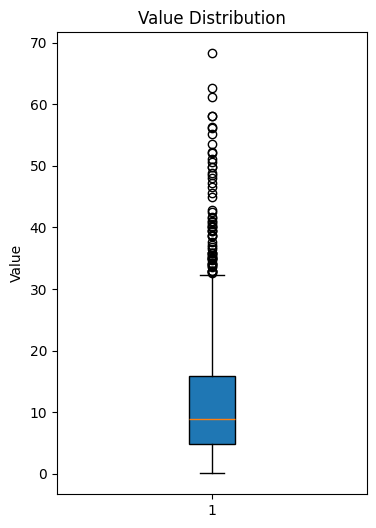

In [ ]:
plt.figure(figsize=(4,6))
values = dfposts_NO2['value'].dropna() # If you don't remove NANs, default matplotlib function will fail
plt.boxplot(values, vert=True, patch_artist=True)
plt.title("Value Distribution")
plt.ylabel("Value")
plt.show()

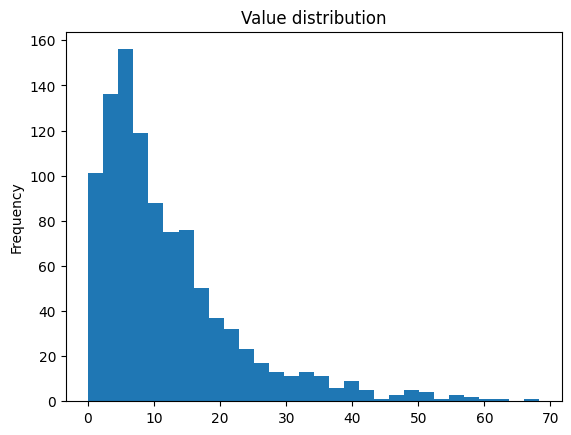

In [ ]:
dfposts_NO2['value'].plot(kind='hist', bins=30, title='Value distribution')
plt.show()



In [ ]:
!pip install seaborn

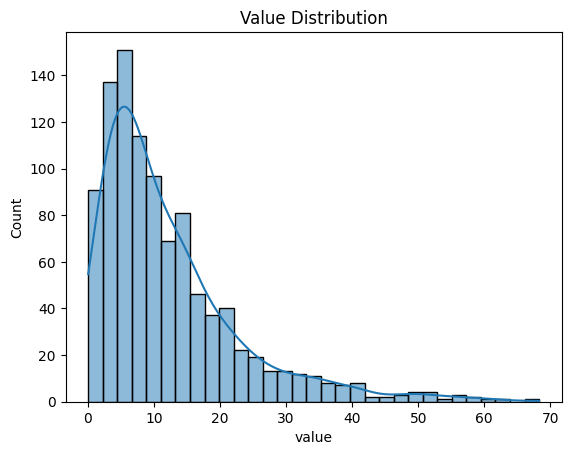

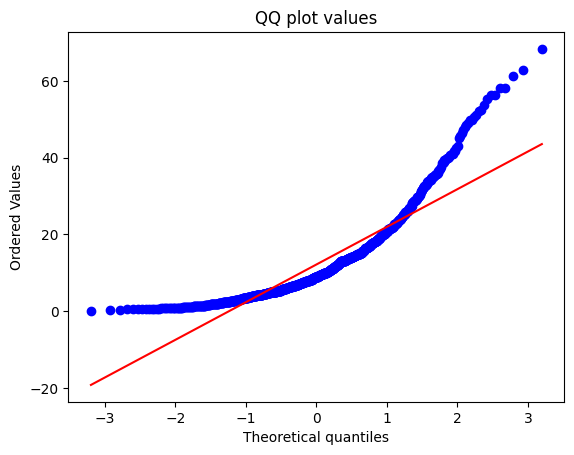

In [ ]:
import scipy.stats as stats
import seaborn as sns 

sns.histplot(values, kde=True)
plt.title("Value Distribution")
plt.show()

stats.probplot(values, dist="norm", plot=plt)
plt.title("QQ plot values")
plt.show()

In [ ]:
print(values.skew())


1.8225715221180363


In [ ]:
c = abs(values.min())

In [ ]:
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt



shift = values + c + 0.001
log_x = np.log(shift)  
print(log_x)



0      2.553422
1      1.835936
2     -0.093212
3      2.825596
4      0.300845
         ...   
995    2.806447
996    2.004314
997    3.282076
998    3.051687
999    2.621112
Name: value, Length: 1000, dtype: float64


In [ ]:
log_x.skew()

np.float64(-0.5450601663367242)

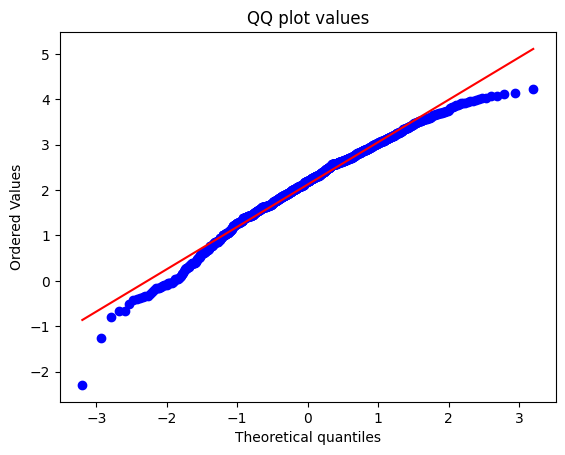

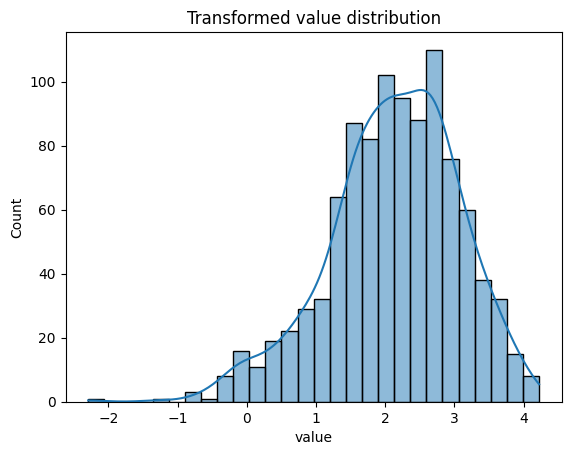

In [ ]:
stats.probplot(log_x, dist="norm", plot=plt)
plt.title("QQ plot values")
plt.show()

sns.histplot(log_x,kde=True)
plt.title("Transformed value distribution")
plt.show()


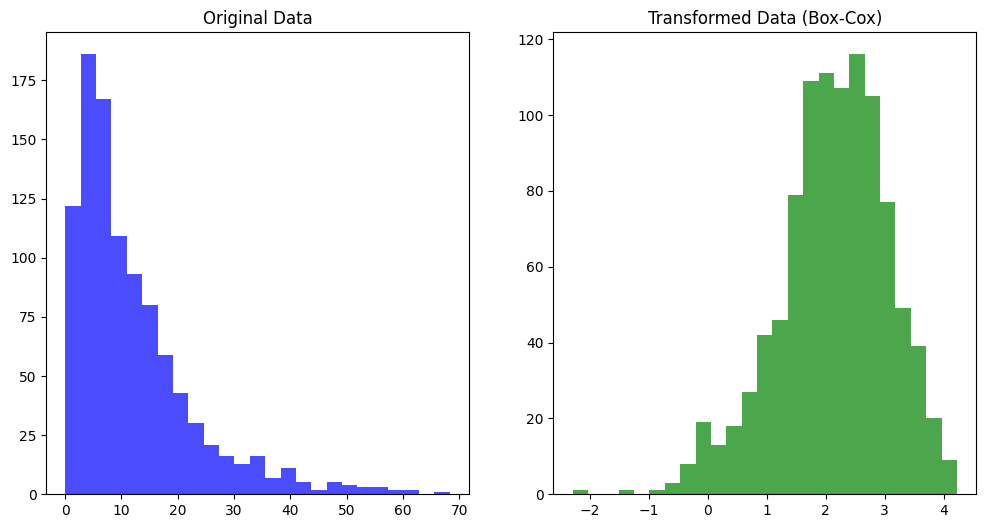

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(values, bins=25, color='blue', alpha=0.7)
plt.title('Original Data')

plt.subplot(1, 2, 2)
plt.hist(log_x, bins=25, color='green', alpha=0.7)
plt.title('Transformed Data (Box-Cox)')

plt.show()

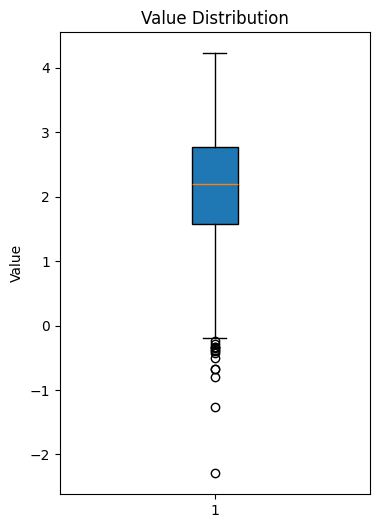

In [ ]:
plt.figure(figsize=(4,6))
plt.boxplot(log_x, vert=True, patch_artist=True)
plt.title("Value Distribution")
plt.ylabel("Value")
plt.show()

For the predicition part, we need to use the log_x data. 

In [ ]:
print(meanprovince)
print(dftotal)

print(meanprovince['value'].mean())


           RegioS      value
0         Drenthe   1.808462
1       Flevoland   8.528750
2       Friesland   1.605200
3      Gelderland  12.053846
4       Groningen   8.498235
5         Limburg   9.615698
6   Noord-Brabant  11.293500
7   Noord-Holland  14.927510
8      Overijssel   2.879615
9         Utrecht   9.857222
10        Zeeland  10.508816
11   Zuid-Holland  15.516104
Aanhangwagen_17                           7357478
Bestelauto_11                             6797487
Bus_15                                      63458
InBezitNatuurlijkePersonenRelatief_6        38589
InBezitNatuurlijkePersonen_5             54388946
MotorfietsenRelatief_20                      3503
Oplegger_18                               1242123
PersonenautoSRelatief_4                     45252
SpeciaalVoertuig_14                        394020
TotaalAanhangwagensEnOpleggers_16         8599601
TotaalAanhangwagensEnOpleggers_9          8599601
TotaalBedrijfsmotorvoertuigen_10          8266837
TotaalBedrijfsmotorvoer

In [ ]:

dfcorrelation = pd.merge(meanprovince, dfprovince, on='RegioS')

correlation = dfcorrelation[['value', 'Sum']].corr()
corr_matrix = go.Figure(data=go.Heatmap(
        z=correlation.values,
        x=correlation.columns,
        y=correlation.index,
        text=correlation.values, #Show the values in the heatmap
        texttemplate="%{text:.2f}",
        colorscale='Viridis')) #Create the heatmap figure

corr_matrix.show()

In [ ]:
url = "https://api.luchtmeetnet.nl/open_api/measurements?formula=PM25" # get data from luchtmeetnet api and filter it so that only PM25 formulas will be retrieved
posts_luchtmeetnet_PM25 = requests.get(url).json()
#pprint(posts_luchtmeetnet_PM25)


In [ ]:
dfposts_PM25 = pd.DataFrame(posts_luchtmeetnet_PM25["data"])[['formula',
           'station_number',
           'timestamp_measured',
           'value']]
print(dfposts_PM25.head(10))



  formula station_number         timestamp_measured  value
0    PM25        NL49680  2025-10-12T15:00:00+00:00   1.20
1    PM25        NL49014  2025-10-12T15:00:00+00:00   2.10
2    PM25        NL10138  2025-10-12T15:00:00+00:00   9.01
3    PM25        NL10644  2025-10-12T15:00:00+00:00   4.86
4    PM25        NL10136  2025-10-12T15:00:00+00:00  12.67
5    PM25        NL49017  2025-10-12T15:00:00+00:00   2.10
6    PM25        NL10641  2025-10-12T15:00:00+00:00   2.09
7    PM25        NL49573  2025-10-12T15:00:00+00:00   3.90
8    PM25        NL10241  2025-10-12T15:00:00+00:00   6.66
9    PM25        NL10230  2025-10-12T15:00:00+00:00   0.38


In [ ]:
meanlocation_PM25 = dfposts_PM25.groupby('station_number')['value'].mean().reset_index()

print(meanlocation_PM25)

   station_number      value
0         NL01485  10.023529
1         NL01487   9.911765
2         NL01488   8.881250
3         NL01489  10.012500
4         NL01491   9.281250
..            ...        ...
57        NL50010  24.357143
58        NL50011  21.400000
59        NL50012  22.600000
60        NL54004  12.493529
61        NL54010  12.353750

[62 rows x 2 columns]


In [ ]:
print(dfposts_PM25["station_number"].isna().sum())
print(dfposts_PM25["station_number"].nunique(), "station points")
print(dfposts_PM25["station_number"].unique())
print(dfposts_NO2["station_number"].value_counts())

0
62 station points
['NL49680' 'NL49014' 'NL10138' 'NL10644' 'NL10136' 'NL49017' 'NL10641'
 'NL49573' 'NL10241' 'NL10230' 'NL01491' 'NL49557' 'NL01488' 'NL10938'
 'NL10450' 'NL10449' 'NL49703' 'NL10131' 'NL10247' 'NL10738' 'NL49701'
 'NL10741' 'NL49980' 'NL54004' 'NL49016' 'NL01489' 'NL01912' 'NL10404'
 'NL49556' 'NL49561' 'NL49003' 'NL01487' 'NL01485' 'NL10636' 'NL49572'
 'NL49704' 'NL10248' 'NL10444' 'NL49553' 'NL54010' 'NL10821' 'NL10418'
 'NL10934' 'NL49012' 'NL01913' 'NL01493' 'NL49007' 'NL10742' 'NL10643'
 'NL49551' 'NL49570' 'NL10240' 'NL01495' 'NL01497' 'NL01494' 'NL10937'
 'NL01496' 'NL50003' 'NL50012' 'NL50007' 'NL50011' 'NL50010']
station_number
NL01493    13
NL10247    13
NL01494    13
NL10807    13
NL01491    13
           ..
NL10445    11
NL50010    11
NL10235    10
NL10641     3
NL10617     3
Name: count, Length: 80, dtype: int64


In [ ]:
import numpy as np
uniqueNO2= dfposts_NO2['station_number'].unique()
print(uniqueNO2)

uniquePM25= dfposts_PM25['station_number'].unique()
print(uniquePM25)

intersection = np.intersect1d(uniqueNO2, uniquePM25)

print(len(intersection))

differenceno2 = np.setdiff1d(uniqueNO2, uniquePM25)
differencepm25 = np.setdiff1d(uniquePM25, uniqueNO2)
print(differencepm25, 'PM25 only')
print(differenceno2, 'NO2 only')


['NL01493' 'NL10230' 'NL10929' 'NL10136' 'NL49680' 'NL10738' 'NL49551'
 'NL10643' 'NL10442' 'NL10633' 'NL10741' 'NL10241' 'NL10918' 'NL10934'
 'NL49002' 'NL10722' 'NL49020' 'NL10449' 'NL01495' 'NL10107' 'NL10131'
 'NL49019' 'NL01487' 'NL01912' 'NL10248' 'NL10639' 'NL10138' 'NL49546'
 'NL10644' 'NL49553' 'NL10246' 'NL10404' 'NL49561' 'NL10446' 'NL10550'
 'NL01494' 'NL10807' 'NL01491' 'NL01913' 'NL10418' 'NL10742' 'NL01497'
 'NL10445' 'NL10450' 'NL49007' 'NL10301' 'NL10240' 'NL10818' 'NL10318'
 'NL49003' 'NL01485' 'NL49022' 'NL54004' 'NL01489' 'NL10133' 'NL49565'
 'NL49021' 'NL10444' 'NL10437' 'NL49703' 'NL49012' 'NL10636' 'NL49701'
 'NL10237' 'NL49017' 'NL01488' 'NL10247' 'NL49564' 'NL10938' 'NL49704'
 'NL10236' 'NL49014' 'NL10937' 'NL50002' 'NL50003' 'NL01496' 'NL50010'
 'NL10235' 'NL10641' 'NL10617']
['NL49680' 'NL49014' 'NL10138' 'NL10644' 'NL10136' 'NL49017' 'NL10641'
 'NL49573' 'NL10241' 'NL10230' 'NL01491' 'NL49557' 'NL01488' 'NL10938'
 'NL10450' 'NL10449' 'NL49703' 'NL10131' 'NL1

In [ ]:

### Vraag , waarom is hier overlap?
PM25_pvencoding = PM25_pvencoding = {'NL49703': 'Noord-Holland',
                  'NL49553': 'Noord-Holland',
                  'NL01493': 'Zuid-Holland',
                  'NL10404': 'Zuid-Holland',
                  'NL10318': 'Zeeland',
                  'NL01912': 'Zeeland',
                  'NL10742': 'Groningen',
                  'NL10538': 'Noord-Holland',
                  'NL01496': 'Zuid-Holland',
                  'NL01495': 'Zuid-Holland', 
                  'NL49007': 'Noord-Holland',
                  'NL10636': 'Utrecht',
                  'NL49564': 'Noord-Holland',
                  'NL10818': 'Overijssel',
                  'NL10550': 'Noord-Holland',
                  'NL49546': 'Noord-Holland',
                  'NL10136': 'Limburg',
                  'NL10235': 'Noord-Brabant',
                  'NL01913': 'Zeeland',
                  'NL10918': 'Friesland',
                  'NL01487': 'Zuid-Holland',
                  'NL10639': 'Utrecht',
                  'NL01497': 'Zeeland',
                  'NL10644': 'Utrecht',
                  'NL10633': 'Utrecht',
                  'NL10741': 'Gelderland',
                  'NL10437': 'Zeeland',
                  'NL10247':'Noord-Brabant', 
                  'NL10445':'Zeeland',
                  'NL10934': 'Friesland',
                  'NL01494': 'Zuid-Holland',
                  'NL10449': 'Zuid-Holland',
                  'NL49017': 'Noord-Holland',
                  'NL49551': 'Noord-Holland',
                  'NL10617': 'Flevoland', 
                  'NL10442': 'Zuid-Holland',
                  'NL10446': 'Zuid-Holland',
                  'NL49565': 'Noord-Holland',
                  'NL10418':'Zuid-Holland',
                  'NL10138': 'Limburg',
                  'NL10450': 'Zuid-Holland',
                  'NL10929': 'Drenthe',
                  'NL49561': 'Noord-Holland', 
                  'NL01485': 'Zuid-Holland',
                  'NL49003': 'Noord-Holland',
                  'NL10246': 'Noord-Brabant', 
                  'NL10133': 'Limburg',
                  'NL49020': 'Noord-Holland', 
                  'NL10444': 'Zuid-Holland',  
                  'NL10738': 'Gelderland',
                  'NL10107': 'Groningen',
                  'NL49680': 'Flevoland', 
                  'NL10643': 'Zuid-Holland', 
                  'NL10248': 'Noord-Brabant', 
                  'NL10240': 'Noord-Holland', 
                  'NL10230': 'Noord-Brabant',
                  'NL10131': 'Limburg', 
                  'NL49021': 'Noord-Holland',
                  'NL10938': 'Zuid-Holland',
                  'NL49019': 'Noord-Holland',
                  'NL49014': 'Noord-Holland',
                  'NL10641': 'Utrecht', 
                  'NL10237': 'Noord-Brabant',
                  'NL01491': 'Zuid-Holland',
                  'NL10236': 'Noord-Brabant',
                  'NL10241': 'Noord-Brabant',
                  'NL49701': 'Noord-Holland',
                  'NL49012': 'Noord-Holland', 
                  'NL10722': 'Gelderland',
                  'NL49704':'Noord-Holland',
                  'NL10807': 'Overijssel',
                  'NL01488': 'Zuid-Holland', 
                  'NL10301': 'Groningen',
                  'NL10937': 'Groningen',
                  'NL49002': 'Noord-Holland',
                  'NL50010': 'Limburg',
                  'NL50002': 'Limburg', 
                  'NL50003': 'Limburg',
                  'NL54004':'Gelderland',
                  'NL01489': 'Zuid-Holland'}

### CHECK OVERLAP BETWEEN THE LUCHTMEETSTATIONS OF PM25 EN PM10

In [ ]:
url = "https://api.luchtmeetnet.nl/open_api/measurements?formula=PM10" # get data from luchtmeetnet api and filter it so that only PM10 formulas will be retrieved
posts_luchtmeetnet_PM10 = requests.get(url).json()
#pprint(posts_luchtmeetnet_PM10)

We know want to put it in a dataframe 

In [ ]:
dfposts_PM25 = pd.DataFrame(posts_luchtmeetnet_PM25["data"])[['formula',
           'station_number',
           'timestamp_measured',
           'value']]
dfposts_PM25.head(10)

,formula,station_number,timestamp_measured,value
0,PM25,NL49680,2025-10-12T15:00:00+00:00,1.20
1,PM25,NL49014,2025-10-12T15:00:00+00:00,2.10
2,PM25,NL10138,2025-10-12T15:00:00+00:00,9.01
3,PM25,NL10644,2025-10-12T15:00:00+00:00,4.86
4,PM25,NL10136,2025-10-12T15:00:00+00:00,12.67
5,PM25,NL49017,2025-10-12T15:00:00+00:00,2.10
6,PM25,NL10641,2025-10-12T15:00:00+00:00,2.09
7,PM25,NL49573,2025-10-12T15:00:00+00:00,3.90
8,PM25,NL10241,2025-10-12T15:00:00+00:00,6.66
9,PM25,NL10230,2025-10-12T15:00:00+00:00,0.38


In [ ]:
dfposts_PM10 = pd.DataFrame(posts_luchtmeetnet_PM10["data"])[['formula',
           'station_number',
           'timestamp_measured',
           'value']]
dfposts_PM10.head(10)

,formula,station_number,timestamp_measured,value
0,PM10,NL01495,2025-10-12T15:00:00+00:00,7.90
1,PM10,NL10404,2025-10-12T15:00:00+00:00,27.47
2,PM10,NL10442,2025-10-12T15:00:00+00:00,18.51
3,PM10,NL49561,2025-10-12T15:00:00+00:00,8.50
4,PM10,NL10450,2025-10-12T15:00:00+00:00,15.95
5,PM10,NL10937,2025-10-12T15:00:00+00:00,10.83
6,PM10,NL10550,2025-10-12T15:00:00+00:00,14.67
7,PM10,NL49020,2025-10-12T15:00:00+00:00,8.60
8,PM10,NL49680,2025-10-12T15:00:00+00:00,6.00
9,PM10,NL49701,2025-10-12T15:00:00+00:00,7.10


###### https://stackoverflow.com/questions/70563254/map-of-a-country-with-plotly

In [ ]:
import requests
import plotly.express as px
import pandas as pd

# get Spain municipal boundaries
res = requests.get(
    "https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/spain-provinces.geojson"
)

# get some cities in Spain
df = (
    pd.json_normalize(
        requests.get(
            "https://opendata.arcgis.com/datasets/6996f03a1b364dbab4008d99380370ed_0.geojson"
        ).json()["features"]
    )
    .loc[
        lambda d: d["properties.CNTRY_NAME"].eq("Netherlands"),
        ["properties.CITY_NAME", "geometry.coordinates"],
    ]
    .assign(
        lon=lambda d: d["geometry.coordinates"].apply(lambda v: v[0]),
        lat=lambda d: d["geometry.coordinates"].apply(lambda v: v[1]),
    )
)

# scatter the cities and add layer that shows municiple boundary
px.scatter_map(df, lat="lat", lon="lon", hover_name="properties.CITY_NAME").update_layout(
    mapbox={
        "style": "carto-positron",
        "zoom": 3.5,
        "layers": [
            {
                "source": res.json(),
                "type": "line",
                "color": "green",
                "line": {"width": 1},
            }
        ],
    }
)

In [ ]:
import geopandas as gpd 
from shapely.geometry import Point, Polygon

zone_poly = Polygon([(0,0), (2,0), (2,2), (0,2)])
zone = gpd.GeoDataFrame({'zone_name':['TestZone']}, geometry=[zone_poly], crs="EPSG:4326")

stations = gpd.GeoDataFrame(
    {'id':[1,2], 'geometry':[Point(1,1), Point(3,3)]},
    crs="EPSG:4326"
)

# Spatial join
result = gpd.sjoin(stations, zone, predicate="within")
print(result)

   id                 geometry  index_right zone_name
0   1  POINT (1.00000 1.00000)            0  TestZone


In [ ]:
NO2_pvencoding = NO2_pvencoding = {'NL49703': 'Noord-Holland',
                  'NL49553': 'Noord-Holland',
                  'NL01493': 'Zuid-Holland',
                  'NL10404': 'Zuid-Holland',
                  'NL10318': 'Zeeland',
                  'NL01912': 'Zeeland',
                  'NL10742': 'Groningen',
                  'NL10538': 'Noord-Holland',
                  'NL01496': 'Zuid-Holland',
                  'NL01495': 'Zuid-Holland', 
                  'NL49007': 'Noord-Holland',
                  'NL10636': 'Utrecht',
                  'NL49564': 'Noord-Holland',
                  'NL10818': 'Overijssel',
                  'NL10550': 'Noord-Holland',
                  'NL49546': 'Noord-Holland',
                  'NL10136': 'Limburg',
                  'NL10235': 'Noord-Brabant',
                  'NL01913': 'Zeeland',
                  'NL10918': 'Friesland',
                  'NL01487': 'Zuid-Holland',
                  'NL10639': 'Utrecht',
                  'NL01497': 'Zeeland',
                  'NL10644': 'Utrecht',
                  'NL10633': 'Utrecht',
                  'NL10741': 'Gelderland',
                  'NL10437': 'Zeeland',
                  'NL10247':'Noord-Brabant', 
                  'NL10445':'Zeeland',
                  'NL10934': 'Friesland',
                  'NL01494': 'Zuid-Holland',
                  'NL10449': 'Zuid-Holland',
                  'NL49017': 'Noord-Holland',
                  'NL49551': 'Noord-Holland',
                  'NL10617': 'Flevoland', 
                  'NL10442': 'Zuid-Holland',
                  'NL10446': 'Zuid-Holland',
                  'NL49565': 'Noord-Holland',
                  'NL10418':'Zuid-Holland',
                  'NL10138': 'Limburg',
                  'NL10450': 'Zuid-Holland',
                  'NL10929': 'Drenthe',
                  'NL49561': 'Noord-Holland', 
                  'NL01485': 'Zuid-Holland',
                  'NL49003': 'Noord-Holland',
                  'NL10246': 'Noord-Brabant', 
                  'NL10133': 'Limburg',
                  'NL49020': 'Noord-Holland', 
                  'NL10444': 'Zuid-Holland',  
                  'NL10738': 'Gelderland',
                  'NL10107': 'Groningen',
                  'NL49680': 'Flevoland', 
                  'NL10643': 'Zuid-Holland', 
                  'NL10248': 'Noord-Brabant', 
                  'NL10240': 'Noord-Holland', 
                  'NL10230': 'Noord-Brabant',
                  'NL10131': 'Limburg', 
                  'NL49021': 'Noord-Holland',
                  'NL10938': 'Zuid-Holland',
                  'NL49019': 'Noord-Holland',
                  'NL49014': 'Noord-Holland',
                  'NL10641': 'Utrecht', 
                  'NL10237': 'Noord-Brabant',
                  'NL01491': 'Zuid-Holland',
                  'NL10236': 'Noord-Brabant',
                  'NL10241': 'Noord-Brabant',
                  'NL49701': 'Noord-Holland',
                  'NL49012': 'Noord-Holland', 
                  'NL10722': 'Gelderland',
                  'NL49704':'Noord-Holland',
                  'NL10807': 'Overijssel',
                  'NL01488': 'Zuid-Holland', 
                  'NL10301': 'Groningen',
                  'NL10937': 'Groningen',
                  'NL49002': 'Noord-Holland',
                  'NL50010': 'Limburg',
                  'NL50002': 'Limburg', 
                  'NL50003': 'Limburg',
                  'NL54004':'Gelderland',
                  'NL01489': 'Zuid-Holland'}

dfposts_NO2['RegioS']  = dfposts_NO2['station_number'].map(NO2_pvencoding)
meanprovince = dfposts_NO2.groupby('RegioS')['value'].mean().reset_index()

print(meanprovince)




           RegioS      value
0         Drenthe   1.808462
1       Flevoland   8.528750
2       Friesland   1.605200
3      Gelderland  12.053846
4       Groningen   8.498235
5         Limburg   9.615698
6   Noord-Brabant  11.293500
7   Noord-Holland  14.927510
8      Overijssel   2.879615
9         Utrecht   9.857222
10        Zeeland  10.508816
11   Zuid-Holland  15.516104


In [ ]:
# AQI_NO2 = {
#     (0, 10): "Good",
#     (11, 25): "Fair",
#     (26, 60): "Moderate",
#     (61, 100): "Poor",
#     (101, 150): "Very Poor",
#     (151, float('inf')): "Extremely Poor"
# }
#     # Color scheme for different pollution levels
#     def no2_colour_pollution(meanprovince):
#         if AQI_NO2 in meanprovince:
#             avg_no2 = meanprovince['avg']
#             if avg_no2 > 150:
#                 return 'red'      
#             elif avg_no2 > 100:
#                
#         else:
#             return 'gray'  # No data available
    
# binning, with colour and range of NO2 
AQI_NO2 = {
    (0, 10):           ("Good",           "green"),
    (10, 25):          ("Fair",           "yellow"),
    (25, 60):          ("Moderate",       "orange"),
    (60, 100):         ("Poor",           "red"),
    (100, 150):        ("Very Poor",      "darkred"),
    (150, math.inf):   ("Extremely Poor", "purple"), 
}

def no2_colour_pollution(meanprovince):
 
    val = meanprovince.get('avg') if hasattr(meanprovince, 'get') else meanprovince #### mean provice is updated form the API on hourl basis 
    if val is None:
        return 'gray'
    try:
        x = float(val)
    except (TypeError, ValueError):
        return 'gray'

    #  (lower  <= x < higer ; between these values retun colour )
    for (lo, hi), (_label, color) in AQI_NO2.items(): 
        if lo <= x < hi:
            return color

    return 'gray'



#AQI_PM_25 = {}
#0-5	6-15	16-50	51-90	91-140	>140 #https://airindex.eea.europa.eu/AQI/index.html# source of these values 


#AQI_PM10 = {}
#0-15	16-45	46-120	121-195	196-270	>270

In [ ]:

#need to install this to get path to geo files for netherlands 
%pip install geodatasets 


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2/2 [geodatasets]
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# interactive map 
%pip install map-nl

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import pandas as pd
from map_nl import ChoroplethMapNL

df = pd.read_csv("https://raw.githubusercontent.com/fpgmaas/map-nl/main/data/woz-pc4.csv")

m = ChoroplethMapNL(geojson_simplify_tolerance=0.0001).plot(
    df, pc4_column_name="pc4", value_column_name="WOZ", legend_name="Average WOZ Value"
)
m.save("map.html")


nl-pc4-map.geojson: 159MiB [00:39, 4.18MiB/s] 
ERROR:fiona._env:PROJ: internal_proj_identify: /Users/fakram/anaconda3/share/proj/proj.db contains DATABASE.LAYOUT.VERSION.MINOR = 2 whereas a number >= 3 is expected. It comes from another PROJ installation.


In [ ]:
m  # of:
from IPython.display import display
display(m)

In [ ]:
from IPython.display import IFrame
IFrame("map.html", width="100%", height=600)

https://python-visualization.github.io/folium/latest/getting_started.html folium explaination 

In [ ]:
%pip install folium geopandas shapely


Note: you may need to restart the kernel to use updated packages.


In [ ]:
world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
nl = world[world["name"] == "Netherlands"].to_crs(epsg=4326)
nl


/var/folders/7r/zf91v2wn2wj557dn1ls_p31h0000gn/T/ipykernel_48858/1497258236.py:1: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.

ERROR:fiona._env:PROJ: internal_proj_identify: /Users/fakram/anaconda3/share/proj/proj.db contains DATABASE.LAYOUT.VERSION.MINOR = 2 whereas a number >= 3 is expected. It comes from another PROJ installation.
ERROR:fiona._env:PROJ: internal_proj_identify: /Users/fakram/anaconda3/share/proj/proj.db contains DATABASE.LAYOUT.VERSION.MINOR = 2 whereas a number >= 3 is expected. It comes from another PROJ installation.


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
130,17332850.0,Europe,Netherlands,NLD,907050,"POLYGON ((6.90514 53.48216, 7.09205 53.14404, ..."


source json file for geographical data, dowloaded the level 2 .json file to make sure i get more detailed data : https://gadm.org/download_country.html

In [ ]:
import json

json_file_path ='/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/gadm41_NLD_2.json'

with open(json_file_path, "r", encoding="utf-8") as f:
    data = json.load(f)

# Controleer  FeatureCollection 
print("Type:", data["type"])
print("Aantal features:", len(data["features"]))

# Print de eerste feature (één gemeente)
first_feature = data["features"][0]

print(json.dumps(first_feature, indent=2))


Type: FeatureCollection
Aantal features: 355
{
  "type": "Feature",
  "properties": {
    "GID_2": "NLD.1.1_1",
    "GID_0": "NLD",
    "COUNTRY": "Netherlands",
    "GID_1": "NLD.1_1",
    "NAME_1": "Drenthe",
    "NL_NAME_1": "NA",
    "NAME_2": "AaenHunze",
    "VARNAME_2": "NA",
    "NL_NAME_2": "NA",
    "TYPE_2": "Gemeente",
    "ENGTYPE_2": "Municipality",
    "CC_2": "NA",
    "HASC_2": "NL.DR.AH"
  },
  "geometry": {
    "type": "MultiPolygon",
    "coordinates": [
      [
        [
          [
            6.5699,
            52.9465
          ],
          [
            6.5899,
            52.967
          ],
          [
            6.6049,
            52.9722
          ],
          [
            6.6051,
            52.9794
          ],
          [
            6.6127,
            52.9829
          ],
          [
            6.6174,
            52.9891
          ],
          [
            6.616,
            52.9945
          ],
          [
            6.6223,
            53.005

In [ ]:
provincie = "Drenthe"

features_in_prov = [
    f for f in data["features"]
    if f["properties"].get("NAME_1") == provincie
]

print(f"Aantal gemeenten in {provincie}:", len(features_in_prov))

for f in features_in_prov[:3]:  
    naam_gemeente = f["properties"].get("NAME_2")
    geom_type = f["geometry"]["type"]
    coords = f["geometry"]["coordinates"]

    if geom_type == "MultiPolygon":
        ring = coords[0][0]           
    elif geom_type == "Polygon":
        ring = coords[0]             
    else:
        print(naam_gemeente, "— onbekend geometrietype:", geom_type)
        continue

    print(f"\nGemeente: {naam_gemeente}  |  Punten in 1e ring: {len(ring)}")
    print("Eerste 5 punten (lon, lat):")
    for pt in ring[:5]:
        print(pt)


Aantal gemeenten in Drenthe: 12

Gemeente: AaenHunze  |  Punten in 1e ring: 52
Eerste 5 punten (lon, lat):
[6.5699, 52.9465]
[6.5899, 52.967]
[6.6049, 52.9722]
[6.6051, 52.9794]
[6.6127, 52.9829]

Gemeente: Assen  |  Punten in 1e ring: 56
Eerste 5 punten (lon, lat):
[6.6408, 53.0257]
[6.6392, 53.023]
[6.6422, 53.0221]
[6.6406, 53.0176]
[6.6223, 53.0053]

Gemeente: Borger-Odoorn  |  Punten in 1e ring: 31
Eerste 5 punten (lon, lat):
[6.7457, 52.8792]
[6.7363, 52.9152]
[6.7339, 52.9377]
[6.7414, 52.9376]
[6.7375, 52.9547]


In [ ]:

from shapely.geometry import shape

provincie = "Drenthe"
features_in_prov = [f for f in data["features"] if f["properties"]["NAME_1"] == provincie]

rows = []
for f in features_in_prov:
    geom = shape(f["geometry"])
    pt = geom.representative_point()  
    rows.append({
        "provincie": f["properties"]["NAME_1"],
        "gemeente":  f["properties"]["NAME_2"],
        "longitude": pt.x,
        "latitude":  pt.y
    })

import pandas as pd
df_points = pd.DataFrame(rows)
print(df_points.head())


  provincie       gemeente  longitude  latitude
0   Drenthe      AaenHunze   6.739450  52.98115
1   Drenthe          Assen   6.558808  52.99990
2   Drenthe  Borger-Odoorn   6.887552  52.89535
3   Drenthe      Coevorden   6.731730  52.75360
4   Drenthe       DeWolden   6.347862  52.70610


In [ ]:

rows = []
for f in data["features"]:
    geom = shape(f["geometry"])             # polygon
    pt = geom.representative_point()      
    
    rows.append({
        "provincie": f["properties"]["NAME_1"],
        "gemeente":  f["properties"]["NAME_2"],
        "longitude": pt.x,
        "latitude":  pt.y
    })


df_points = pd.DataFrame(rows)

print("Aantal gemeenten:", len(df_points))
print(df_points.head())



Aantal gemeenten: 355
  provincie       gemeente  longitude  latitude
0   Drenthe      AaenHunze   6.739450  52.98115
1   Drenthe          Assen   6.558808  52.99990
2   Drenthe  Borger-Odoorn   6.887552  52.89535
3   Drenthe      Coevorden   6.731730  52.75360
4   Drenthe       DeWolden   6.347862  52.70610


In [ ]:
from shapely.geometry import shape
from shapely.ops import unary_union
import json, pandas as pd

path ='/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/gadm41_NLD_2.json'
with open(path, "r", encoding="utf-8") as f:
    data = json.load(f)

# geometries per provicen
prov_geoms = {}
for f in data["features"]:
    prov = f["properties"]["NAME_1"]
    prov_geoms.setdefault(prov, []).append(shape(f["geometry"]))

# provincie en representative point
rows_prov = []
for prov, geoms in prov_geoms.items():
    merged = unary_union(geoms)        
    pt = merged.representative_point()   
    rows_prov.append({
        "provincie": prov,
        "longitude": pt.x,
        "latitude":  pt.y,
        "gemeenten_cnt": len(geoms)
    })

df_prov = pd.DataFrame(rows_prov).sort_values("provincie")
print(df_prov.to_string(index=False))






         provincie  longitude  latitude  gemeenten_cnt
           Drenthe   6.694162  52.90885             12
         Flevoland   5.517085  52.42985              6
           Fryslân   5.671104  53.10855             18
        Gelderland   6.092604  52.12855             51
         Groningen   6.891854  53.15130             10
        IJsselmeer   5.487862  52.66705              1
           Limburg   5.824285  51.25290             31
     Noord-Brabant   4.686077  51.52570             61
     Noord-Holland   4.823775  52.56360             47
        Overijssel   6.388020  52.48510             25
           Utrecht   5.146886  52.08190             26
           Zeeland   3.892031  51.30375             13
      Zeeuwsemeren   3.961520  51.56610              1
      Zuid-Holland   4.499344  52.01000             52
ZuidHollandseMeren   4.223212  51.76840              1


In [ ]:
#number of municipalities in each province/region
print("Aantal gemeenten per provincie:", len(df_points))
df_points.groupby("provincie")["gemeente"].nunique().sort_values(ascending=False)

Aantal gemeenten per provincie: 355


provincie
Noord-Brabant         61
Zuid-Holland          52
Gelderland            51
Noord-Holland         47
Limburg               31
Utrecht               26
Overijssel            25
Fryslân               18
Zeeland               13
Drenthe               12
Groningen             10
Flevoland              6
IJsselmeer             1
Zeeuwsemeren           1
ZuidHollandseMeren     1
Name: gemeente, dtype: int64

In [ ]:
print("Information on datapoins to inspect a province/region")
df_points[df_points["provincie"] == "Utrecht"].sort_values("gemeente")

Information on datapoins to inspect a province/region


,provincie,gemeente,longitude,latitude
262,Utrecht,Amersfoort,5.415339,52.16405
263,Utrecht,Baarn,5.256019,52.19535
264,Utrecht,Bunnik,5.225342,52.03990
265,Utrecht,Bunschoten,5.361346,52.23890
266,Utrecht,DeBilt,5.175905,52.13970
267,Utrecht,DeRondeVenen,4.925621,52.23370
268,Utrecht,Eemnes,5.281607,52.24915
269,Utrecht,Houten,5.183597,52.00480
270,Utrecht,IJsselstein,5.032587,52.02640
271,Utrecht,Leusden,5.425050,52.12770


In [ ]:
%pip install folium 
import folium 

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import requests

m = folium.Map(tiles="cartodbpositron")

geojson_data ='/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/gadm41_NLD_2.json'

folium.GeoJson(geojson_data, name="hello world").add_to(m)

folium.LayerControl().add_to(m)

m

In [ ]:
%pip install  rioxarray
%pip install earthpy

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
# Import necessary packages
import os
import folium
from folium import plugins
import rioxarray as rxr
import earthpy as et
import earthpy.spatial as es
import pandas as pd
import geopandas as gpd
import numpy as np

# Import data from EarthPy
data = et.data.get_data('colorado-flood')

# Set working directory to earth-analytics
os.chdir(os.path.join(et.io.HOME, 'earth-analytics', 'data'))

In [3]:
center_lat = 52.2
center_lon = 5.3

m = folium.Map(
        location=[center_lat, center_lon],
        zoom_start=7,
        tiles='CartoDB Positron'
    )
m

In [1]:

import geopandas as gpd
import pandas as pd
import os

geojson_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/Preprocessors/georef-netherlands-provincie.geojson"
json_url    = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/Preprocessors/georef-netherlands-provincie.json"


print("GeoJSON file exists:", os.path.isfile(geojson_url))
print("JSON file exists:", os.path.isfile(json_url))



GeoJSON file exists: False
JSON file exists: False


In [12]:
import geopandas as gpd
import pandas as pd

#geojson_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/refs/heads/main/main/Preprocessors/georef-netherlands-provincie.geojson?token=GHSAT0AAAAAADMVWCBUMWGD2MFSWC5C7FUQ2HNJZMQ"
#json_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/refs/heads/main/main/Preprocessors/georef-netherlands-provincie.json?token=GHSAT0AAAAAADMVWCBVWBXD4HOAC2BXJDGI2HNJZ7Q"

#geojson_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/data/ProcessedData/georef-netherlands-provincie.geojson"
#json_url    = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/data/ProcessedData/georef-netherlands-provincie.json"

geojson_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/Preprocessors/georef-netherlands-provincie.geojson"
json_url    = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/Preprocessors/georef-netherlands-provincie.json"


gdf = gpd.read_file(geojson_url)
print(gdf.head())


URLError: <urlopen error [Errno 8] nodename nor servname provided, or not known>

In [11]:
import geopandas as gpd
import requests
import tempfile

# Gebruik de raw GitHub link (zonder token, refs/heads, etc.)
#geojson_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/main/main/Preprocessors/georef-netherlands-provincie.geojson"

json_url = "https://raw.githubusercontent.com/R-Zaid/DSS-project/refs/heads/main/main/Preprocessors/georef-netherlands-provincie.json?token=GHSAT0AAAAAADMVWCBVWBXD4HOAC2BXJDGI2HNJZ7Q"


# Download bestand via requests
response = requests.get(json_url)
response.raise_for_status()  # geeft foutmelding als de download mislukt

# Tijdelijk bestand aanmaken
with tempfile.NamedTemporaryFile(suffix=".geojson", delete=False) as tmp_file:
    tmp_file.write(response.content)
    tmp_path = tmp_file.name

# Nu kan GeoPandas het bestand openen
gdf = gpd.read_file(tmp_path)
print(gdf.head())


HTTPError: 404 Client Error: Not Found for url: https://raw.githubusercontent.com/R-Zaid/DSS-project/refs/heads/main/main/Preprocessors/georef-netherlands-provincie.json?token=GHSAT0AAAAAADMVWCBVWBXD4HOAC2BXJDGI2HNJZ7Q

In [ ]:
#example of marker 

folium.Marker(
    location=[center_lat, center_lon], # coordinates for the marker
    popup='centre', # pop-up label for the marker
    icon=folium.Icon(color='red', icon='info-sign', icon_color='white')
).add_to(m)

m

In [ ]:
gdf = pd.read_json("/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/georef-netherlands-provincie.geojson")


df = pd.read_json("/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/georef-netherlands-provincie.json")

#uniqe non overlapping province names 
gdf['prov_name'] = df['prov_name']


gdf.head()

,type,features,prov_name
0,FeatureCollection,"{'type': 'Feature', 'geometry': {'coordinates'...",[Noord-Holland]
1,FeatureCollection,"{'type': 'Feature', 'geometry': {'coordinates'...",[Zeeland]
2,FeatureCollection,"{'type': 'Feature', 'geometry': {'coordinates'...",[Drenthe]
3,FeatureCollection,"{'type': 'Feature', 'geometry': {'coordinates'...",[Noord-Brabant]
4,FeatureCollection,"{'type': 'Feature', 'geometry': {'coordinates'...",[Flevoland]


In [ ]:
import pandas as pd

# DataFrame with provincies & features
province_data = gdf[['prov_name', 'features']].copy()

print(province_data)


          prov_name                                           features
0   [Noord-Holland]  {'type': 'Feature', 'geometry': {'coordinates'...
1         [Zeeland]  {'type': 'Feature', 'geometry': {'coordinates'...
2         [Drenthe]  {'type': 'Feature', 'geometry': {'coordinates'...
3   [Noord-Brabant]  {'type': 'Feature', 'geometry': {'coordinates'...
4       [Flevoland]  {'type': 'Feature', 'geometry': {'coordinates'...
5       [Groningen]  {'type': 'Feature', 'geometry': {'coordinates'...
6    [Zuid-Holland]  {'type': 'Feature', 'geometry': {'coordinates'...
7         [Utrecht]  {'type': 'Feature', 'geometry': {'coordinates'...
8         [Limburg]  {'type': 'Feature', 'geometry': {'coordinates'...
9      [Gelderland]  {'type': 'Feature', 'geometry': {'coordinates'...
10     [Overijssel]  {'type': 'Feature', 'geometry': {'coordinates'...
11        [Fryslân]  {'type': 'Feature', 'geometry': {'coordinates'...


In [ ]:
import pandas as pd
import folium

gdf = pd.read_json("/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/georef-netherlands-provincie.geojson")
df = pd.read_json("/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/georef-netherlands-provincie.json")
gdf['prov_name'] = df['prov_name']

center_lat = 52.2
center_lon = 5.3
m = folium.Map(location=[center_lat, center_lon], zoom_start=7, tiles='CartoDB Positron')

# every province
for index, row in gdf.iterrows():
    geometry = row['features']['geometry']
    folium.GeoJson(
        geometry,
        name=row['prov_name'][0]  # to take  provincie name snd match
    ).add_to(m)

folium.LayerControl().add_to(m)

m

In [ ]:

import math
AQI_NO2 = {
    (0, 10):           ("Good",           "green"),
    (10, 25):          ("Fair",           "yellow"),
    (25, 60):          ("Moderate",       "orange"),
    (60, 100):         ("Poor",           "red"),
    (100, 150):        ("Very Poor",      "darkred"),
    (150, math.inf):   ("Extremely Poor", "purple"),
}

def no2_colour_pollution(val):
    if val is None or (isinstance(val, float) and pd.isna(val)):
        return "gray"
    try:
        x = float(val)
    except (TypeError, ValueError):
        return "gray"
    for (lo, hi), (_label, color) in AQI_NO2.items():
        if lo <= x < hi:
            return color
    return "gray"

# to allign province naam (Fryslân -> Friesland)
def norm_prov(p):
    if isinstance(p, list) and len(p) > 0:
        p = p[0]
    if isinstance(p, str):
        p = p.strip()
    return {"Fryslân": "Friesland"}.get(p, p)

gdf = pd.read_json("/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/georef-netherlands-provincie.geojson")

df  = pd.read_json("/Users/fakram/anaconda3/DSS/DSS!/main/Preprocessors/georef-netherlands-provincie.json")
gdf["prov_name"] = df["prov_name"]

#  'province' colums to match meanprovince -
gdf["province"] = gdf["prov_name"].apply(norm_prov)


mp = meanprovince.copy()
mp["province"] = mp["RegioS"].apply(norm_prov)
mean_map = dict(zip(mp["province"], mp["value"]))   # province -> NO2_mean

# add NO2_mean to gdf via with matching province name 
gdf["NO2_mean"] = gdf["province"].map(mean_map)


#map
center_lat, center_lon = 52.2, 5.3
m = folium.Map(location=[center_lat, center_lon], zoom_start=7, tiles="CartoDB Positron")

for _, row in gdf.iterrows():
    prov = row["province"]
    geometry = row["features"]["geometry"]         
    mean_no2 = row["NO2_mean"]
    color = no2_colour_pollution(mean_no2)

    folium.GeoJson(
        geometry,
        style_function=lambda _x, c=color: {
            "fillColor": c,
            "color": "black",
            "weight": 2,
            "fillOpacity": 0.55,
        },
        name=prov,
        tooltip=folium.Tooltip(f"{prov}<br>NO₂ (mean): {mean_no2:.2f}" if pd.notna(mean_no2) else f"{prov}<br>NO₂: n.v.t.")
    ).add_to(m)

folium.LayerControl().add_to(m)
m


In [ ]:
from branca.element import Template, MacroElement

def legenda(m, bins=AQI_NO2, title="Air Quality (NO₂)", unit="µg/m³"):
    items = sorted(((lo, hi, lbl, col) for (lo, hi), (lbl, col) in bins.items()), key=lambda t: t[0])
    rows = "".join(
        f'<div style="display:flex;align-items:center;margin:4px 0">'
        f'<span style="background:{col};width:12px;height:12px;border:1px solid #555;margin-right:8px"></span>'
        f'<span style="font-size:12px">{lbl} '
        f'<span style="color:#777">({int(lo)}–{("∞" if not math.isfinite(hi) else int(hi))} {unit})</span></span>'
        f'</div>' for lo, hi, lbl, col in items
    )
    html = ('<div style="position:fixed;bottom:20px;left:20px;z-index:9999;background:#fff;'
            'padding:8px 10px;border:1px solid #bbb;border-radius:4px;box-shadow:0 1px 4px rgba(0,0,0,.2)">'
            f'<div style="font-weight:600;margin-bottom:6px">{title}</div>{rows}</div>')
    macro = MacroElement(); macro._template = Template("{% macro html(this, kwargs) %}"+html+"{% endmacro %}")
    m.get_root().add_child(macro)

legenda(m)
m


In [ ]:

# NO2-pvencoding mapping
NO2_pvencoding = {'NL49703': 'Noord-Holland',
                  'NL49553': 'Noord-Holland',
                  'NL01493': 'Zuid-Holland',
                  'NL10404': 'Zuid-Holland',
                  'NL10318': 'Zeeland',
                  'NL01912': 'Zeeland',
                  'NL10742': 'Groningen',
                  'NL10538': 'Noord-Holland',
                  'NL01496': 'Zuid-Holland',
                  'NL01495': 'Zuid-Holland', 
                  'NL49007': 'Noord-Holland',
                  'NL10636': 'Utrecht',
                  'NL49564': 'Noord-Holland',
                  'NL10818': 'Overijssel',
                  'NL10550': 'Noord-Holland',
                  'NL49546': 'Noord-Holland',
                  'NL10136': 'Limburg',
                  'NL10235': 'Noord-Brabant',
                  'NL01913': 'Zeeland',
                  'NL10918': 'Friesland',
                  'NL01487': 'Zuid-Holland',
                  'NL10639': 'Utrecht',
                  'NL01497': 'Zeeland',
                  'NL10644': 'Utrecht',
                  'NL10633': 'Utrecht',
                  'NL10741': 'Gelderland',
                  'NL10437': 'Zeeland',
                  'NL10247':'Noord-Brabant', 
                  'NL10445':'Zeeland',
                  'NL10934': 'Friesland',
                  'NL01494': 'Zuid-Holland',
                  'NL10449': 'Zuid-Holland',
                  'NL49017': 'Noord-Holland',
                  'NL49551': 'Noord-Holland',
                  'NL10617': 'Flevoland', 
                  'NL10442': 'Zuid-Holland',
                  'NL10446': 'Zuid-Holland',
                  'NL49565': 'Noord-Holland',
                  'NL10418':'Zuid-Holland',
                  'NL10138': 'Limburg',
                  'NL10450': 'Zuid-Holland',
                  'NL10929': 'Drenthe',
                  'NL49561': 'Noord-Holland', 
                  'NL01485': 'Zuid-Holland',
                  'NL49003': 'Noord-Holland',
                  'NL10246': 'Noord-Brabant', 
                  'NL10133': 'Limburg',
                  'NL49020': 'Noord-Holland', 
                  'NL10444': 'Zuid-Holland',  
                  'NL10738': 'Gelderland',
                  'NL10107': 'Groningen',
                  'NL49680': 'Flevoland', 
                  'NL10643': 'Zuid-Holland', 
                  'NL10248': 'Noord-Brabant', 
                  'NL10240': 'Noord-Holland', 
                  'NL10230': 'Noord-Brabant',
                  'NL10131': 'Limburg', 
                  'NL49021': 'Noord-Holland',
                  'NL10938': 'Zuid-Holland',
                  'NL49019': 'Noord-Holland',
                  'NL49014': 'Noord-Holland',
                  'NL10641': 'Utrecht', 
                  'NL10237': 'Noord-Brabant',
                  'NL01491': 'Zuid-Holland',
                  'NL10236': 'Noord-Brabant',
                  'NL10241': 'Noord-Brabant',
                  'NL49701': 'Noord-Holland',
                  'NL49012': 'Noord-Holland', 
                  'NL10722': 'Gelderland',
                  'NL49704':'Noord-Holland',
                  'NL10807': 'Overijssel',
                  'NL01488': 'Zuid-Holland', 
                  'NL10301': 'Groningen',
                  'NL10937': 'Groningen',
                  'NL49002': 'Noord-Holland',
                  'NL50010': 'Limburg',
                  'NL50002': 'Limburg', 
                  'NL50003': 'Limburg',
                  'NL54004':'Gelderland',
                  'NL01489': 'Zuid-Holland'
                  
                }

    # Voeg hier de rest van de mapping toe

dfposts_NO2['RegioS']  = dfposts_NO2['station_number'].map(NO2_pvencoding)
meanprovince = dfposts_NO2.groupby('RegioS')['value'].mean().reset_index()

#print(meanprovince)

# Koppel regio's aan de NO2 data
dfposts_NO2['RegioS'] = dfposts_NO2['station_number'].map(NO2_pvencoding)

# Gemiddelde NO2-waarde per provincie berekenen
meanprovince = dfposts_NO2.groupby('RegioS')['value'].mean().reset_index()

# Bekijk de resultaten
print(meanprovince)

NameError: name 'dfposts_NO2' is not defined

In [ ]:
print(gdf.info())
print(gdf.head())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   type       12 non-null     object
 1   features   12 non-null     object
 2   prov_name  12 non-null     object
dtypes: object(3)
memory usage: 420.0+ bytes
None
                type                                           features  \
0  FeatureCollection  {'type': 'Feature', 'geometry': {'coordinates'...   
1  FeatureCollection  {'type': 'Feature', 'geometry': {'coordinates'...   
2  FeatureCollection  {'type': 'Feature', 'geometry': {'coordinates'...   
3  FeatureCollection  {'type': 'Feature', 'geometry': {'coordinates'...   
4  FeatureCollection  {'type': 'Feature', 'geometry': {'coordinates'...   

         prov_name  
0  [Noord-Holland]  
1        [Zeeland]  
2        [Drenthe]  
3  [Noord-Brabant]  
4      [Flevoland]  


Read me this section, i can add it above each cell as well let me know 

## Started by getting hourly NO₂ data from the API.
## To map each station to one of the 12 provinces with NO2_pvencoding (station_number → province).

## In preprocessing to map each station to one of the 12 provinces with NO2_pvencoding and then I compute the mean NO₂ value per province:
dfposts_NO2['RegioS'] = dfposts_NO2['station_number'].map(NO2_pvencoding)
meanprovince = dfposts_NO2.groupby('RegioS')['value'].mean().reset_index() 
* with output : RegioS = province name & value = mean NO₂ for that province

## Then I look at the real NO₂ ranges from the European standard (EEA Air Quality Index). I use these ranges and colors for the map:
-> source : https://airindex.eea.europa.eu/AQI/index.html#
AQI_NO2 = {
    (0, 10):   ("Good", "green"),
    (10, 25):  ("Fair", "yellow"),
    (25, 60):  ("Moderate", "orange"),
    (60, 100): ("Poor", "red"),
    (100,150): ("Very Poor", "darkred"),
    (150,inf): ("Extremely Poor", "purple"),
} 
# later on Function no2_colour_pollution(val) converts a number to one color using the AQI bins.
* Lower bound is inclusive, upper bound is exclusive: lo <= x < hi.


## I load geographical data from a .json and a .geojson file. I make sure the province name is the same in both sources so I can join values to shapes. I also normalize the name for Fryslân → Friesland.
gdf = pd.read_json(".../georef-netherlands-provincie.geojson")
df  = pd.read_json(".../georef-netherlands-provincie.json")
gdf["prov_name"] = df["prov_name"]
gdf["province"]  = gdf["prov_name"].apply(norm_prov)  # Fryslân -> Friesland

## Next I join the NO₂ mean values from meanprovince to the geographical data by province name:
mp = meanprovince.copy()
mp["province"] = mp["RegioS"].apply(norm_prov)
mean_map = dict(zip(mp["province"], mp["value"]))
gdf["NO2_mean"] = gdf["province"].map(mean_map)

#### Ploted interactive map Netherlands for each province coloured AQI assigned ####

## The map is made with Folium. Each province polygon uses the color from the NO₂ range. On hover I show the province name and the NO₂ mean. I add a legend that lists the ranges.
* georef-netherlands-provincie.geojson –>   province geometries.
* georef-netherlands-provincie.json –>   province names (prov_name).
* * meanprovince – DataFrame with columns:
    * * RegioS (province name string)
    * * * value (mean NO₂ for that province, from the API after mapping station → province).
# The legend displays the NO₂ ranges and labels from the AQI bins. The map uses the CartoDB Positron base layer and can be saved as HTML.


# Main libraries used 
* pandas (tables)
* folium (interactive map)
* branca (legend HTML)
* geopandas (to work with GeoDataFrames)
* numpy, math (ranges)
* earthpy / rioxarray (in my environment for map, not required for the final map)



